# Image Classifier of List vs Non-List Document pages 

In [14]:
import tensorflow as tf

In [2]:
tf.__version__


'2.4.0'

In [34]:
# from tensorflow.python.client import device_lib
# device_lib.list_local_devices()

In [11]:
import matplotlib.pyplot as plt
import numpy as np
import os
import PIL
import tensorflow as tf

from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

import wandb
import os

In [17]:
from wandb.keras import WandbCallback

In [23]:
img_width, img_height = 256, 256
train_data_dir ='/home/infrrd/Au/StateNational/SN2-list_nonlist_image_dataset/train' 
val_data_dir = '/home/infrrd/Au/StateNational/SN2-list_nonlist_image_dataset/val'
batch_size = 32
epochs = 100
classes = 2
nb_train_samples = 3000
nb_validation_samples = 548

learning_rate = 0.0001

In [37]:
# WandB – Config is a variable that holds and saves hyperparameters and inputs
config = wandb.config          # Initialize config
config.batch_size = batch_size         # Input batch size for training
config.learning_rate = learning_rate    # Learning rate
config.epochs = epochs      # Number of epochs to train
config.train_samples = nb_train_samples 
config.val_samples = nb_validation_samples
config.num_classes = classes  
config.images_size = img_width

In [20]:
wandb.init(project='SN2_list_vs_nonlist',config = config, reinit=True)
os.environ["CUDA_VISIBLE_DEVICES"]="0"

epoch,15
loss,0.11757
accuracy,0.95233
val_loss,0.86308
val_accuracy,0.50365
_runtime,2423
_timestamp,1614933301
_step,15
best_val_loss,0.62157
best_epoch,5


epoch,▁▁▂▂▃▃▄▄▅▅▆▆▇▇██
loss,█▂▂▂▂▂▂▂▁▂▂▁▁▁▁▁
accuracy,▁▅▅▇▇▆▇▇▇▇▇▇▇███
val_loss,▁▁▁▂▁▁▁▂▁█▁▁▄▅▃▁
val_accuracy,▂▅▆▂▆█▂▂▅▁▇▇▃▂▇▃
_runtime,▁▁▂▂▃▃▄▄▅▅▆▆▇▇██
_timestamp,▁▁▂▂▃▃▄▄▅▅▆▆▇▇██
_step,▁▁▂▂▃▃▄▄▅▅▆▆▇▇██


### Model: EfficientNetB2


In [38]:
model = tf.keras.applications.EfficientNetB2(weights = "imagenet",
                                             include_top= False,
                                             input_shape=(img_width, img_height, 3))
#model.summary()


Models Tried:
- Resnet50
- EfficientNetB2


In [22]:
x = model.output
x = layers.Flatten()(x)
x = layers.Dense(1024, activation = "relu")(x)
x= layers.Dropout(0.5)(x)
x = layers.Dense(classes, activation = "softmax")(x)
model_final = tf.keras.Model(inputs = model.input, outputs = x)

In [11]:
model_final.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
rescaling (Rescaling)           (None, 256, 256, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
normalization (Normalization)   (None, 256, 256, 3)  7           rescaling[0][0]                  
__________________________________________________________________________________________________
stem_conv_pad (ZeroPadding2D)   (None, 257, 257, 3)  0           normalization[0][0]              
______________________________________________________________________________________________

In [21]:
train_datagen = ImageDataGenerator(rescale = 1./255,
                                  horizontal_flip = True,
                                  fill_mode = "nearest",
                                  zoom_range = 0.3,
                                  width_shift_range = 0.3,
                                  height_shift_range = 0.3,
                                  rotation_range = 30)


test_datagen = ImageDataGenerator(rescale = 1./255)


In [24]:
train_generator = train_datagen.flow_from_directory(train_data_dir,
                                                    target_size = (img_height, img_width),
                                                    batch_size = batch_size,
                                                    class_mode = "categorical")

validation_generator = test_datagen.flow_from_directory(val_data_dir,
                                                        target_size = (img_height, img_width),
                                                        class_mode = "categorical")

Found 3000 images belonging to 2 classes.
Found 548 images belonging to 2 classes.


In [25]:
# adding the ModelCheckpoint and EarlyStopping callbacks for the training

checkpoint1 = ModelCheckpoint("SN2_efficientNetB2_1.h5",
                              monitor='val_loss',
                              verbose=1,
                              save_best_only=True,
                              save_weights_only=False,
                              mode='auto')

checkpoint2 = EarlyStopping(monitor='val_loss',
                            min_delta=0,
                            patience=10,
                            verbose=0,
                            mode='auto',
                            baseline=None,
                            restore_best_weights=True)


### Training: soft start for 10 epochs with lr = 0.001 followed by full training with lr = 0.0001 and EarlyStopping

In [28]:
# soft start for better initialization of last 4 layers

for layer in model_final.layers[-4:]:
    layer.trainable= True


model_final.compile(optimizer =tf.keras.optimizers.Adam(0.001),
                    loss = "categorical_crossentropy",
                    metrics =["accuracy"])

# model_final.summary()
history = model_final.fit_generator(train_generator,
                          steps_per_epoch = nb_train_samples/batch_size,
                          epochs = 10,
                          validation_data = validation_generator,
                          validation_steps = nb_validation_samples/batch_size,
                          callbacks = [checkpoint1, checkpoint2,WandbCallback()])


Epoch 1/10
93/93 [==============================] - 160s 2s/step - loss: 4.5543 - accuracy: 0.6604 - val_loss: 0.8104 - val_accuracy: 0.5474

Epoch 00001: val_loss improved from inf to 0.81039, saving model to SN2_efficientNetB2_1.h5
Epoch 2/10
93/93 [==============================] - 151s 2s/step - loss: 0.2980 - accuracy: 0.8648 - val_loss: 0.7995 - val_accuracy: 0.5474

Epoch 00002: val_loss improved from 0.81039 to 0.79954, saving model to SN2_efficientNetB2_1.h5
Epoch 3/10
93/93 [==============================] - 149s 2s/step - loss: 0.2728 - accuracy: 0.8893 - val_loss: 0.7833 - val_accuracy: 0.4526

Epoch 00003: val_loss improved from 0.79954 to 0.78333, saving model to SN2_efficientNetB2_1.h5
Epoch 4/10
93/93 [==============================] - 149s 2s/step - loss: 0.2228 - accuracy: 0.9182 - val_loss: 0.7714 - val_accuracy: 0.4526

Epoch 00004: val_loss improved from 0.78333 to 0.77139, saving model to SN2_efficientNetB2_1.h5
Epoch 5/10
93/93 [==============================] - 

In [29]:
# Making all Layers as learnable with a smaller learning rate(10-4)

for layer in model_final.layers:
    layer.trainable= True


model_final.compile(optimizer =tf.keras.optimizers.Adam(0.0001),
                    loss = "categorical_crossentropy",
                    metrics =["accuracy"])

# model_final.summary()
history = model_final.fit_generator(train_generator,
                          steps_per_epoch = nb_train_samples/batch_size,
                          epochs = epochs,
                          validation_data = validation_generator,
                          validation_steps = nb_validation_samples/batch_size,
                          callbacks = [checkpoint1, checkpoint2,WandbCallback()])


Epoch 1/100
93/93 [==============================] - 157s 2s/step - loss: 0.1350 - accuracy: 0.9509 - val_loss: 0.7197 - val_accuracy: 0.5511

Epoch 00001: val_loss did not improve from 0.69244
Epoch 2/100
93/93 [==============================] - 146s 2s/step - loss: 0.0769 - accuracy: 0.9719 - val_loss: 0.6995 - val_accuracy: 0.4526

Epoch 00002: val_loss did not improve from 0.69244
Epoch 3/100
93/93 [==============================] - 148s 2s/step - loss: 0.0700 - accuracy: 0.9701 - val_loss: 0.5099 - val_accuracy: 0.7336

Epoch 00003: val_loss improved from 0.69244 to 0.50993, saving model to SN2_efficientNetB2_1.h5
Epoch 4/100
93/93 [==============================] - 147s 2s/step - loss: 0.0789 - accuracy: 0.9697 - val_loss: 0.6053 - val_accuracy: 0.6496

Epoch 00004: val_loss did not improve from 0.50993
Epoch 5/100
93/93 [==============================] - 145s 2s/step - loss: 0.0804 - accuracy: 0.9735 - val_loss: 0.2806 - val_accuracy: 0.9398

Epoch 00005: val_loss improved from 

### Saving and Evaluating Final Model

In [30]:
# tf.keras.models.save_model(
#     model_final,'/home/infrrd/Au/StateNational/list_nonlist_efficientnetB2.h5', overwrite=True, include_optimizer=True, save_format=None,
#     signatures=None, options=None, save_traces=True
# )

In [19]:
model_final = tf.keras.models.load_model('/home/infrrd/Au/StateNational/list_nonlist_efficientnetB2.h5')

In [25]:
# Evaluation On Val Set
print(model_final.metrics_names)
results_val = model_final.evaluate(validation_generator)

results_val_dict = {model_final.metrics_names[0]:results_val[0],
                   model_final.metrics_names[1]:results_val[1]}

print("results for validation set: ",results_val_dict)

['loss', 'accuracy']
18/18 [==============================] - 21s 956ms/step - loss: 0.1555 - accuracy: 0.9562
results for validation set:  {'loss': 0.15552519261837006, 'accuracy': 0.956204354763031}


In [28]:
# Evaluation On Train Set

train_generator_eval = test_datagen.flow_from_directory(train_data_dir,
                                                        target_size = (img_height, img_width),
                                                        class_mode = "categorical")

results_train = model_final.evaluate(train_generator_eval)

results_train_dict = {model_final.metrics_names[0]:results_train[0],
                   model_final.metrics_names[1]:results_train[1]}

print("results for Train set: ",results_train_dict)

Found 3000 images belonging to 2 classes.
94/94 [==============================] - 99s 1s/step - loss: 0.1389 - accuracy: 0.9560
results for Train set:  {'loss': 0.1389254927635193, 'accuracy': 0.9559999704360962}


In [ ]:
model_final = tf.keras.models.load_model('/home/infrrd/Au/StateNational/list_nonlist_efficientnetB2.h5')

In [180]:
#Evaluation on Test Set
test_data_dir = '/home/infrrd/Au/StateNational/list_nonlist_images'
test_generator_eval = test_datagen.flow_from_directory(test_data_dir,
                                                        target_size = (img_height, img_width),
                                                        class_mode = "categorical")
results_test = model_final.evaluate(test_generator_eval)
results_test_dict = {model_final.metrics_names[0]:results_test[0],
                   model_final.metrics_names[1]:results_test[1]}

print("results for Test set: ",results_test_dict)

Found 4427 images belonging to 2 classes.
139/139 [==============================] - 146s 1s/step - loss: 0.0925 - accuracy: 0.9860
results for Test set:  {'loss': 0.09250716120004654, 'accuracy': 0.9859950542449951}


### Final Hyperparams
    - lr = 0.001 for soft start
    - epochs = 10 for softstart
    - lr = 0.0001 for full training
    - model = efficientNetB2
    - optimizer = adam
    - metric = accuracy
  

### Prediction Code

In [57]:
model_path = '/home/infrrd/Au/StateNational/list_nonlist_efficientnetB2.h5'
img_path = '/home/infrrd/Au/StateNational/SN2-list_nonlist_image_dataset/val/List/Multiple_Carrier-List_9_list_31-2.jpg'

In [16]:
model = tf.keras.models.load_model(model_path)

In [128]:
def preprocess_img(img_path):
    img =tf.keras.preprocessing.image.load_img(img_path,
                                               grayscale=False,
                                               color_mode="rgb",
                                               target_size=(img_height,img_width),
                                               interpolation="nearest")
    img_arr = tf.keras.preprocessing.image.img_to_array(img)
    img_arr = img_arr/255.
    img_arr = np.array([img_arr])
    return img, img_arr

In [211]:
class Prediction(object):
    def __init__(self, model_path):
        self.model_path = model_path
        self.model = tf.keras.models.load_model(model_path)
        self.class_map = {'0': 'List', '1': 'NonList'}

    def predict(self,img_path):
        _,img = preprocess_img(img_path)
        pred = self.model.predict(img)
        predicted_class = pred[0].argmax(axis=-1)
        confidence = max(pred[0])
        print(f"the prediction is : {self.class_map[str(predicted_class)]}, with the confidence of: {confidence}")

        return {'class' : self.class_map[str(predicted_class)],'confidence': confidence}


In [212]:
pred_obj = Prediction(model_path)

In [214]:
pred_obj.predict(img_path)

the prediction is : List, with the confidence of: 0.5763907432556152


{'class': 'List', 'confidence': 0.57639074}

### VISUALIZATION

In [200]:
# tf.keras.utils.plot_model(
#     model, to_file='model.png', show_shapes=True, show_dtype=False,
#     show_layer_names=True, rankdir='TB', expand_nested=False, dpi=96
# )

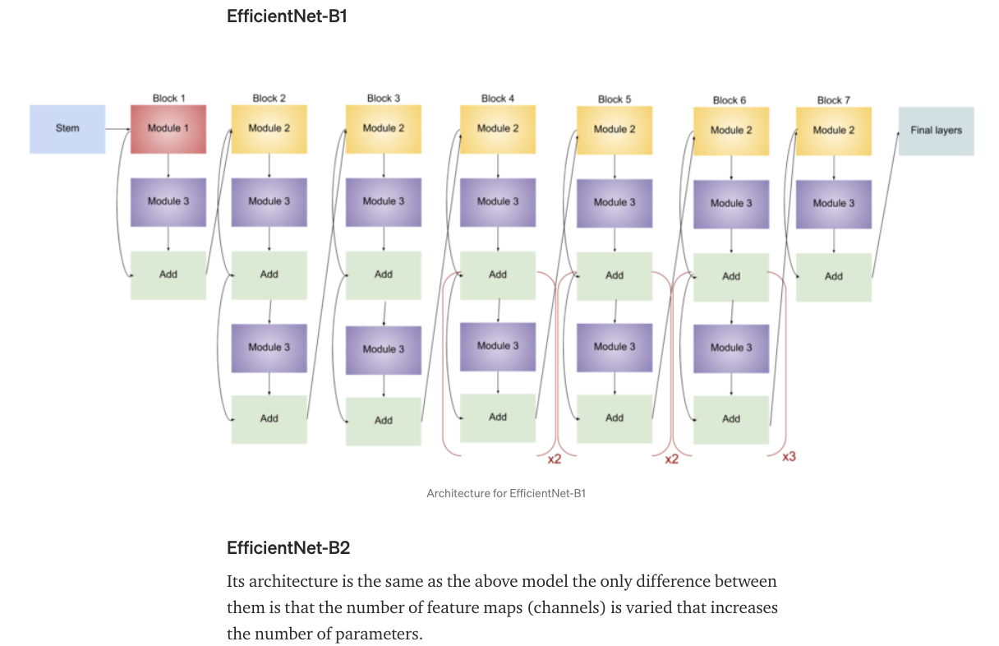

where 

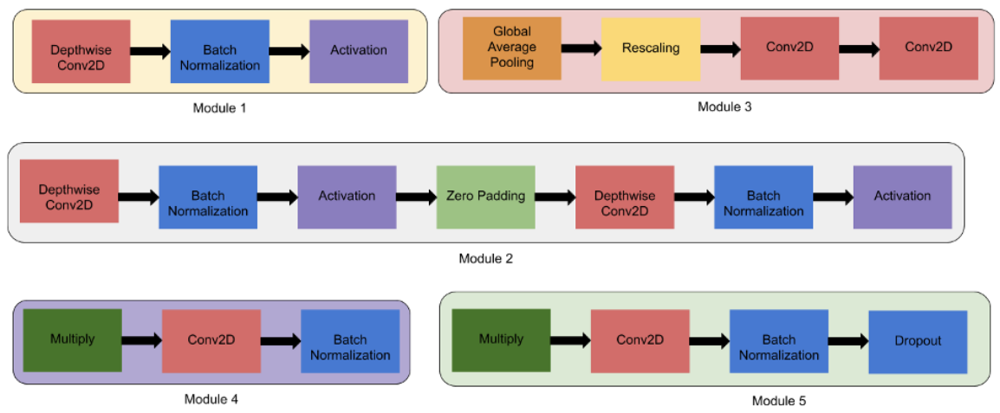



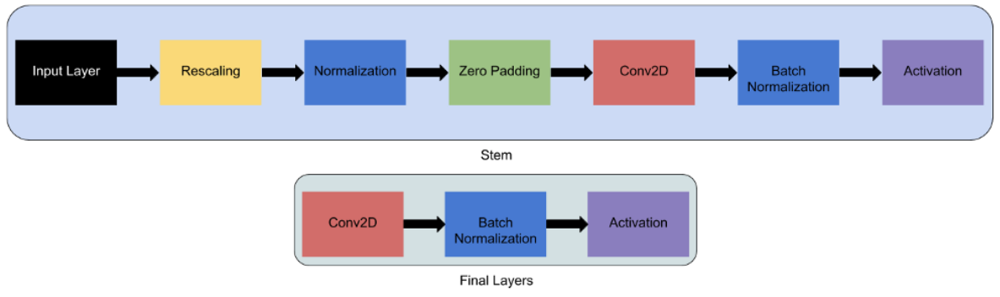



source: https://towardsdatascience.com/complete-architectural-details-of-all-efficientnet-models-5fd5b736142

In [208]:
model = tf.keras.models.load_model(model_path)

In [181]:
# select all the layers for which you want to visualize the outputs and store it in a list
outputs = [layer.output for layer in model.layers[1:]]
outputs = []
layer_names = []
# store the layer names we are interested in (only the CONV layers in this case)
for layer in model.layers[1:]:
    if 'conv' in layer.name:
        layer_names.append(layer.name.split("/")[0])
        outputs.append(layer.output)
        
# Define a new model that generates the above output
vis_model = tf.keras.Model(model.input, outputs)
      
print("Layers going to be used for visualization: ")
print(layer_names)

Layers going to be used for visualization: 
['stem_conv_pad', 'stem_conv', 'block1a_dwconv', 'block1a_project_conv', 'block1b_dwconv', 'block1b_project_conv', 'block2a_expand_conv', 'block2a_dwconv_pad', 'block2a_dwconv', 'block2a_project_conv', 'block2b_expand_conv', 'block2b_dwconv', 'block2b_project_conv', 'block2c_expand_conv', 'block2c_dwconv', 'block2c_project_conv', 'block3a_expand_conv', 'block3a_dwconv_pad', 'block3a_dwconv', 'block3a_project_conv', 'block3b_expand_conv', 'block3b_dwconv', 'block3b_project_conv', 'block3c_expand_conv', 'block3c_dwconv', 'block3c_project_conv', 'block4a_expand_conv', 'block4a_dwconv_pad', 'block4a_dwconv', 'block4a_project_conv', 'block4b_expand_conv', 'block4b_dwconv', 'block4b_project_conv', 'block4c_expand_conv', 'block4c_dwconv', 'block4c_project_conv', 'block4d_expand_conv', 'block4d_dwconv', 'block4d_project_conv', 'block5a_expand_conv', 'block5a_dwconv', 'block5a_project_conv', 'block5b_expand_conv', 'block5b_dwconv', 'block5b_project_co

In [184]:
def get_CAM(processed_image, predicted_label, layer_name='top_conv'):
    """
    This function is used to generate a heatmap for a sample image prediction.
    
    Args:
        processed_image: any sample image that has been pre-processed using the 
                       `preprocess_img function
        predicted_label: label predicted by the network for this image
    
    Returns:
        heatmap: heatmap generated over the last convolution layer output 
    """
    
    # this will be the model that would give us the graidents
    model_grad = tf.keras.Model([model.inputs], 
                                [model.get_layer(layer_name).output, model.output])
    
    # Gradient tape gives you everything you need
    with tf.GradientTape() as tape:
        conv_output_values, predictions = model_grad(processed_image)
        loss = predictions[:, predicted_label]
    
    # get the gradients wrt to the chosen layer
    grads_values = tape.gradient(loss, conv_output_values)
    
    # take mean gradient per feature map
    grads_values = K.mean(grads_values, axis=(0,1,2))
    
    # convert to numpy. This is done just for image operations.
    # Check for shapes and you would understand why we performed 
    # the squeeze operation here.
    conv_output_values = np.squeeze(conv_output_values.numpy())
    grads_values = grads_values.numpy()
    
    
    # iterate over each feature map in yout conv output and multiply
    # the gradient values with the conv output values. This gives an 
    # indication of "how important a feature is"
    for i in range(1408): # we have 1408 features in our last conv layer
        conv_output_values[:,:,i] *= grads_values[i]
    
    # create a heatmap
    heatmap = np.mean(conv_output_values, axis=-1)
    
    # remove negative values
    heatmap = np.maximum(heatmap, 0)
    
    # normalize
    heatmap /= heatmap.max()
    
    del model_grad, conv_output_values, grads_values, loss
    return heatmap

In [206]:
def show_random_sample(path_list ,idx):
    """
    This function is used to select a random sample from the validation set.
    It generates prediction for the same. It also stores the heatmap and the intermediate
    layers activation maps.
    
    Arguments:
        path_list: the list of paths for all the files in the test directory
        idx: random index to select a sample from validation data
    
    Returns:
        activations: activation values for intermediate layers
    """
    path = path_list[idx]
    sample_label = path.split('/')[-2] #specific to my directory structure can do this from a df
    sample_image, sample_image_processed = preprocess_img(path)
    
#     print(sample_image_processed.shape)
    # generate activation maps from the intermediate layers using the visualization model
    activations = vis_model.predict(sample_image_processed)
#     print(len(activations))
    
    # get the label predicted by our original model
    pred_label = np.argmax(model.predict(sample_image_processed), axis=-1)[0]
    
    # choose any random activation map from the activation maps 
    # the last value(2 here) here would depend on the layer selected[12th entry here]
    # just for visualization
    sample_activation = activations[12][0,:,:,2]
    
    # normalize the sample activation map
    sample_activation-=sample_activation.mean()
    sample_activation/=sample_activation.std()
    
    # convert pixel values between 0-255
    sample_activation *=255
    sample_activation = np.clip(sample_activation, 0, 255).astype(np.uint8)
    
    
    # get the heatmap for class activation map(CAM)
    heatmap = get_CAM(sample_image_processed, pred_label)
    heatmap = cv2.resize(heatmap, (sample_image_processed.shape[1], sample_image_processed.shape[2]))
    heatmap = heatmap *255
    heatmap = np.clip(heatmap, 0, 255).astype(np.uint8)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    #fading heatmap over the image
    super_imposed_image = heatmap * 0.5 + sample_image
    super_imposed_image = np.clip(super_imposed_image, 0,255).astype(np.uint8)

    f,ax = plt.subplots(2,2, figsize=(16,8))
    ax[0,0].imshow(sample_image)
    ax[0,0].set_title(f"True label: {sample_label} \n Predicted label: {pred_label}")
    ax[0,0].axis('off')
    
    ax[0,1].imshow(sample_activation)
    ax[0,1].set_title("Random feature map")
    ax[0,1].axis('off')
    
    ax[1,0].imshow(heatmap)
    ax[1,0].set_title("Class Activation Map")
    ax[1,0].axis('off')
    
    ax[1,1].imshow(super_imposed_image)
    ax[1,1].set_title("Activation map superimposed")
    ax[1,1].axis('off')
    plt.show()
    
    return activations

In [186]:
import glob
import cv2
import tensorflow.keras.backend as K

In [187]:
image_paths_notlist = glob.glob("/home/infrrd/Au/StateNational/SN2-list_nonlist_image_dataset/val/NotList/*.jpg")
image_paths = glob.glob("/home/infrrd/Au/StateNational/SN2-list_nonlist_image_dataset/val/List/*.jpg")

In [188]:
len(image_paths_notlist)

248

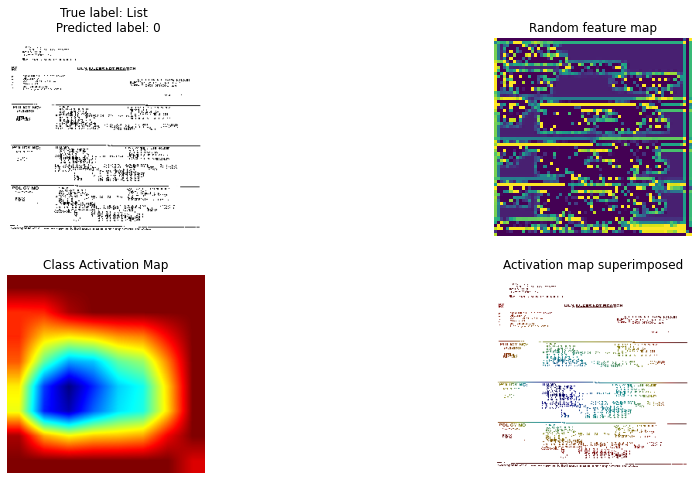

In [207]:
activations = show_random_sample(image_paths, 112)

In [209]:
def visualize_intermediate_activations(layer_names, activations):
    """
    This function is used to visualize all the itermediate activation maps
    
    Arguments:
        layer_names: list of names of all the intermediate layers we chose
        activations: all the intermediate activation maps 
    """
    assert len(layer_names)==len(activations), "Make sure layers and activation values match"
    images_per_row=16
    
    for layer_name, layer_activation in zip(layer_names, activations):
        nb_features = layer_activation.shape[-1]
        size= layer_activation.shape[1]

        nb_cols = nb_features // images_per_row
        grid = np.zeros((size*nb_cols, size*images_per_row))
#         print("layer activation shape : ",layer_activation.shape)

        for col in range(nb_cols):
            for row in range(images_per_row):
                feature_map = layer_activation[0,:,:,col*images_per_row + row]
                feature_map -= feature_map.mean()
                feature_map /= feature_map.std()
                feature_map *=255
                feature_map = np.clip(feature_map, 0, 255).astype(np.uint8)

                grid[col*size:(col+1)*size, row*size:(row+1)*size] = feature_map

        scale = 1./size
        plt.figure(figsize=(scale*grid.shape[1], scale*grid.shape[0]))
        plt.title(layer_name)
        plt.grid(False)
        plt.imshow(grid, aspect='auto', cmap='viridis')
    plt.show()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:34: UserWarning: Attempting to set identical bottom == top == -0.5 results in singular transformations; automatically expanding.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


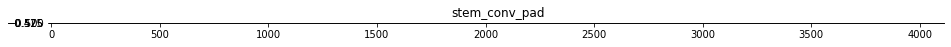

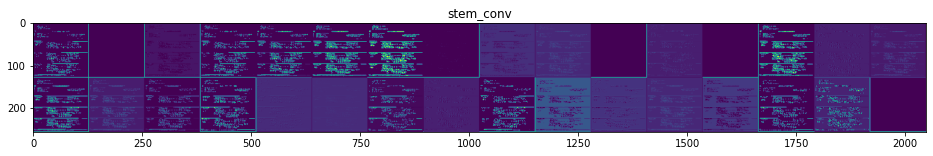

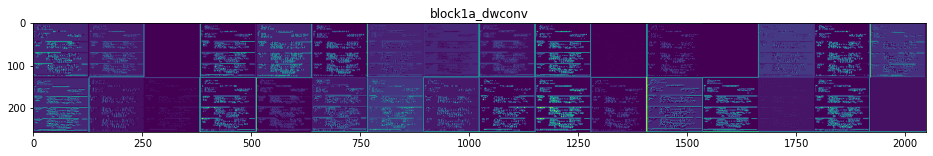

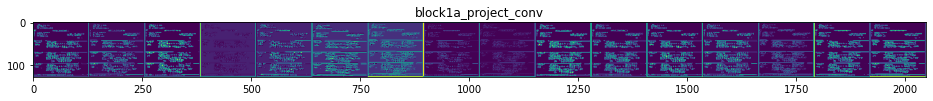

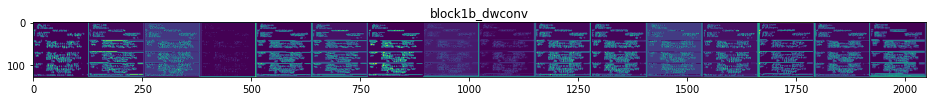

...

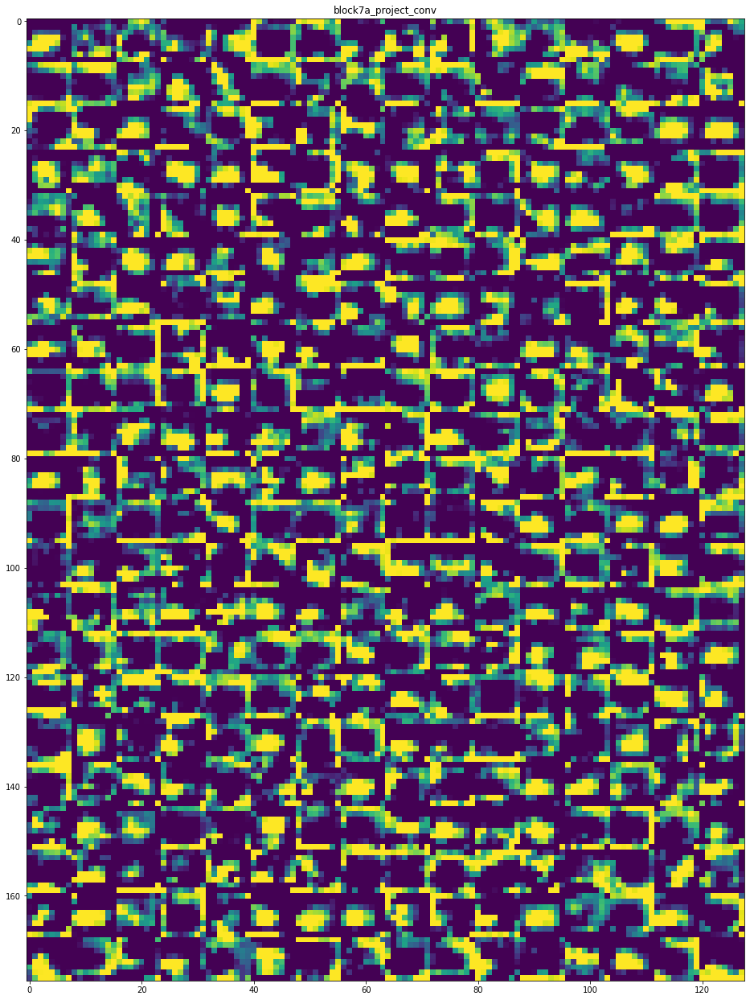

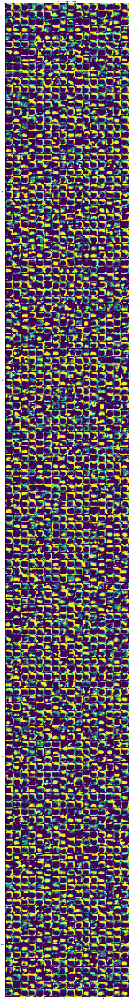

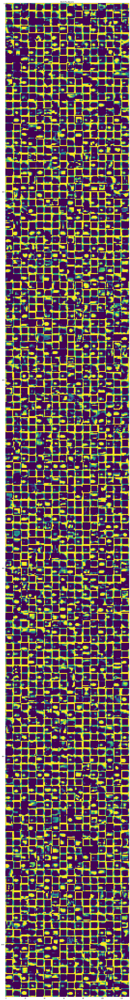

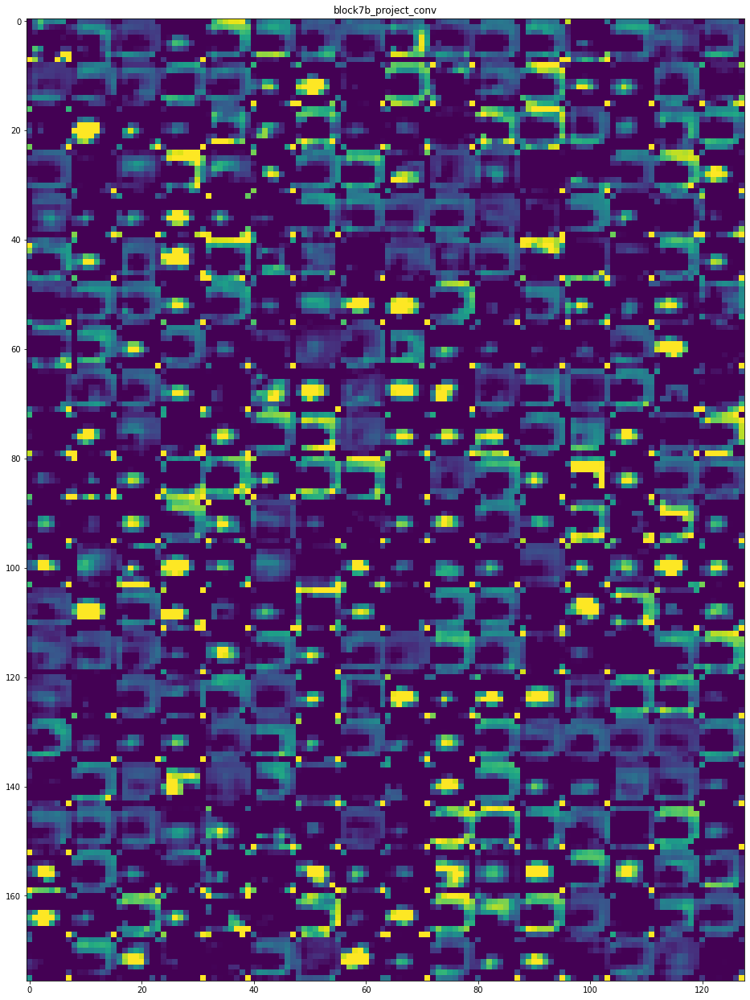

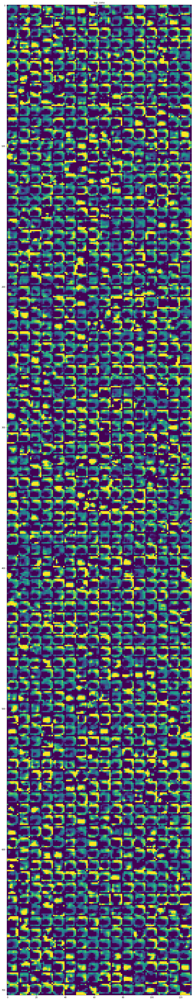

In [210]:
visualize_intermediate_activations(activations=activations, 
                                   layer_names=layer_names)

In [201]:
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 256, 256, 3) 0                                            
__________________________________________________________________________________________________
rescaling_1 (Rescaling)         (None, 256, 256, 3)  0           input_2[0][0]                    
__________________________________________________________________________________________________
normalization_1 (Normalization) (None, 256, 256, 3)  7           rescaling_1[0][0]                
__________________________________________________________________________________________________
stem_conv_pad (ZeroPadding2D)   (None, 257, 257, 3)  0           normalization_1[0][0]            
____________________________________________________________________________________________